In [58]:
# Import required libraries and dependencies
import pandas as pd
import hvplot.pandas
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

In [62]:
# Read your DataFrame from the CSV file
df_team_stat = pd.read_csv("team_stats_merge_4.csv")


# Convert the 'season_id' column to string
df_team_stat['season_id'] = df_team_stat['season_id'].astype(str)

# Slice the first four characters (the year) from the string
df_team_stat['season_id'] = df_team_stat['season_id'].str[:4]

# Convert the 'season_id' column to a date-year format
df_team_stat['season_id'] = pd.to_datetime(df_team_stat['season_id'], format='%Y')

# Print DataFrame information
df_team_stat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 854 entries, 0 to 853
Data columns (total 28 columns):
 #   Column                             Non-Null Count  Dtype         
---  ------                             --------------  -----         
 0   team_stat_id                       0 non-null      float64       
 1   team_id                            854 non-null    int64         
 2   season_id                          854 non-null    datetime64[ns]
 3   team_stats_gamesPlayed             854 non-null    int64         
 4   team_stats_wins                    854 non-null    int64         
 5   team_stats_losses                  854 non-null    int64         
 6   team_stats_ot                      854 non-null    int64         
 7   team_stats_pts                     854 non-null    int64         
 8   team_stats_ptPctg                  854 non-null    float64       
 9   team_stats_goalsPerGame            854 non-null    float64       
 10  team_stats_goalsAgainstPerGame     854

In [63]:
# Converting season _id into year only
df_team_stat['season_id'] = df_team_stat['season_id'].dt.year
df_team_stat.set_index('season_id', inplace=True)
# Display sample data
df_team_stat.head(10)

,team_stat_id,team_id,team_stats_gamesPlayed,team_stats_wins,team_stats_losses,team_stats_ot,team_stats_pts,team_stats_ptPctg,team_stats_goalsPerGame,team_stats_goalsAgainstPerGame,...,team_stats_shotsAllowed,team_stats_winScoreFirst,team_stats_winOppScoreFirst,team_stats_winLeadFirstPer,team_stats_winLeadSecondPer,team_stats_winOutshootOpp,team_stats_winOutshotByOpp,team_name,team_location,winning_team
season_id,,,,,,,,,,,,,,,,,,,,,
1991,NaN,1,80,38,31,0,87,54.4,3.613,3.238,...,28.6250,0.711,0.262,0.793,0.805,0.490,0.414,New Jersey Devils,New Jersey,0
1992,NaN,1,84,40,37,0,87,51.8,3.667,3.560,...,29.8095,0.641,0.333,0.769,0.838,0.510,0.452,New Jersey Devils,New Jersey,0
1993,NaN,1,84,47,25,0,106,63.1,3.643,2.619,...,29.0119,0.717,0.368,0.897,0.921,0.607,0.444,New Jersey Devils,New Jersey,0
1994,NaN,1,48,22,18,0,52,54.2,2.833,2.521,...,25.3750,0.600,0.304,0.667,0.714,0.533,0.313,New Jersey Devils,New Jersey,1
1995,NaN,1,82,37,33,0,86,52.4,2.622,2.463,...,26.5000,0.643,0.250,0.677,0.774,0.475,0.381,New Jersey Devils,New Jersey,0
1996,NaN,1,82,45,23,0,104,63.4,2.817,2.220,...,26.3415,0.678,0.217,0.714,0.767,0.474,0.700,New Jersey Devils,New Jersey,0
1997,NaN,1,82,48,23,0,107,65.2,2.744,2.024,...,23.6951,0.717,0.417,0.844,0.872,0.667,0.316,New Jersey Devils,New Jersey,0
1998,NaN,1,82,47,24,0,105,64.0,3.024,2.390,...,24.7073,0.735,0.333,0.781,0.841,0.548,0.533,New Jersey Devils,New Jersey,0
1999,NaN,1,82,45,24,5,103,62.8,3.061,2.476,...,25.6220,0.622,0.459,0.700,0.882,0.587,0.471,New Jersey Devils,New Jersey,1


In [65]:
# To see how many column are there to confrim what are the column are not relevant 
print(df_team_stat.columns)

Index(['team_stat_id', 'team_id', 'team_stats_gamesPlayed', 'team_stats_wins',
       'team_stats_losses', 'team_stats_ot', 'team_stats_pts',
       'team_stats_ptPctg', 'team_stats_goalsPerGame',
       'team_stats_goalsAgainstPerGame', 'team_stats_evGGARatio',
       'team_stats_powerPlayPercentage', 'team_stats_powerPlayGoals',
       'team_stats_powerPlayGoalsAgainst', 'team_stats_powerPlayOpportunities',
       'team_stats_penaltyKillPercentage', 'team_stats_shotsPerGame',
       'team_stats_shotsAllowed', 'team_stats_winScoreFirst',
       'team_stats_winOppScoreFirst', 'team_stats_winLeadFirstPer',
       'team_stats_winLeadSecondPer', 'team_stats_winOutshootOpp',
       'team_stats_winOutshotByOpp', 'team_name', 'team_location',
       'winning_team'],
      dtype='object')


In [66]:
# To drop column what are not required to tarin model
columns_to_drop = ['team_stat_id','team_id','team_location','winning_team','team_name'] 
df_team_stat.drop(columns=columns_to_drop, inplace=True)
df_team_stat.head()

,team_stats_gamesPlayed,team_stats_wins,team_stats_losses,team_stats_ot,team_stats_pts,team_stats_ptPctg,team_stats_goalsPerGame,team_stats_goalsAgainstPerGame,team_stats_evGGARatio,team_stats_powerPlayPercentage,...,team_stats_powerPlayOpportunities,team_stats_penaltyKillPercentage,team_stats_shotsPerGame,team_stats_shotsAllowed,team_stats_winScoreFirst,team_stats_winOppScoreFirst,team_stats_winLeadFirstPer,team_stats_winLeadSecondPer,team_stats_winOutshootOpp,team_stats_winOutshotByOpp
season_id,,,,,,,,,,,,,,,,,,,,,
1991,80,38,31,0,87,54.4,3.613,3.238,1.2314,17.5,...,338.0,81.8,31.1875,28.6250,0.711,0.262,0.793,0.805,0.490,0.414
1992,84,40,37,0,87,51.8,3.667,3.560,1.2314,19.2,...,400.0,81.4,33.0238,29.8095,0.641,0.333,0.769,0.838,0.510,0.452
1993,84,47,25,0,106,63.1,3.643,2.619,0.7616,18.3,...,333.0,81.1,31.6310,29.0119,0.717,0.368,0.897,0.921,0.607,0.444
1994,48,22,18,0,52,54.2,2.833,2.521,0.7616,13.4,...,164.0,81.2,30.0833,25.3750,0.600,0.304,0.667,0.714,0.533,0.313
1995,82,37,33,0,86,52.4,2.622,2.463,1.0000,14.9,...,368.0,84.6,32.1585,26.5000,0.643,0.250,0.677,0.774,0.475,0.381


In [67]:
# Generate summary statistics
df_team_stat.describe()

,team_stats_gamesPlayed,team_stats_wins,team_stats_losses,team_stats_ot,team_stats_pts,team_stats_ptPctg,team_stats_goalsPerGame,team_stats_goalsAgainstPerGame,team_stats_evGGARatio,team_stats_powerPlayPercentage,...,team_stats_powerPlayOpportunities,team_stats_penaltyKillPercentage,team_stats_shotsPerGame,team_stats_shotsAllowed,team_stats_winScoreFirst,team_stats_winOppScoreFirst,team_stats_winLeadFirstPer,team_stats_winLeadSecondPer,team_stats_winOutshootOpp,team_stats_winOutshotByOpp
count,854.000000,854.000000,854.000000,854.000000,854.000000,854.000000,854.000000,854.000000,854.000000,854.000000,...,854.000000,854.000000,854.000000,854.000000,854.000000,854.000000,854.000000,854.000000,854.000000,854.000000
mean,78.601874,37.540984,30.791569,6.357143,85.351288,54.294496,2.862175,2.845776,1.019054,18.179742,...,305.625293,81.895433,29.816301,29.690025,0.651379,0.303925,0.721354,0.831550,0.488311,0.464929
std,9.444391,9.238793,8.500390,4.498804,18.532017,9.831862,0.405272,0.420152,0.190659,3.273579,...,82.930712,3.211949,2.318999,2.602253,0.108930,0.105763,0.112076,0.082713,0.120204,0.121536
min,48.000000,9.000000,7.000000,0.000000,23.000000,14.300000,1.829000,1.890000,0.544400,8.900000,...,117.000000,71.000000,23.719500,22.122000,0.185000,0.060000,0.231000,0.500000,0.120000,0.094000
25%,82.000000,31.000000,25.000000,3.000000,74.000000,47.600000,2.585000,2.537000,0.889250,15.900000,...,244.000000,80.000000,28.286275,28.027450,0.587000,0.226250,0.655000,0.781000,0.406250,0.378000
50%,82.000000,38.000000,30.000000,7.000000,88.000000,55.500000,2.817000,2.805000,1.007400,18.000000,...,301.000000,82.000000,29.752900,29.710800,0.667000,0.298000,0.734000,0.844000,0.500000,0.467000
75%,82.000000,44.000000,36.000000,10.000000,99.000000,61.225000,3.085300,3.085000,1.156700,20.300000,...,367.000000,84.300000,31.391025,31.411550,0.729000,0.375000,0.800000,0.889000,0.576000,0.547250
max,84.000000,65.000000,71.000000,18.000000,135.000000,82.300000,4.415000,4.929000,1.745600,32.400000,...,541.000000,89.600000,37.341500,39.109800,0.915000,0.657000,1.000000,1.000000,0.808000,0.900000


In [68]:
# Plot your data to see what's in your DataFrame
df_team_stat.hvplot.line(
    width=800,
    height=400,
    rot=90
)

:NdOverlay   [Variable]
   :Curve   [season_id]   (value)

---

### Prepare the Data

In [71]:
#  the `StandardScaler()` module from scikit-learn to normalize the data from the CSV file
df_team_stat_scaled = StandardScaler().fit_transform(
    df_team_stat[['team_stats_gamesPlayed',
       'team_stats_wins', 'team_stats_losses', 'team_stats_ot',
       'team_stats_pts', 'team_stats_ptPctg', 'team_stats_goalsPerGame',
       'team_stats_goalsAgainstPerGame', 'team_stats_evGGARatio',
       'team_stats_powerPlayPercentage', 'team_stats_powerPlayGoals',
       'team_stats_powerPlayGoalsAgainst', 'team_stats_powerPlayOpportunities',
       'team_stats_penaltyKillPercentage', 'team_stats_shotsPerGame',
       'team_stats_shotsAllowed', 'team_stats_winScoreFirst',
       'team_stats_winOppScoreFirst', 'team_stats_winLeadFirstPer',
       'team_stats_winLeadSecondPer', 'team_stats_winOutshootOpp',
       'team_stats_winOutshotByOpp']])


In [72]:
# Create a DataFrame with the scaled data
df_team_stat_scaled = pd.DataFrame(
    df_team_stat_scaled,
    columns= ['team_stats_gamesPlayed',
       'team_stats_wins', 'team_stats_losses', 'team_stats_ot',
       'team_stats_pts', 'team_stats_ptPctg', 'team_stats_goalsPerGame',
       'team_stats_goalsAgainstPerGame', 'team_stats_evGGARatio',
       'team_stats_powerPlayPercentage', 'team_stats_powerPlayGoals',
       'team_stats_powerPlayGoalsAgainst', 'team_stats_powerPlayOpportunities',
       'team_stats_penaltyKillPercentage', 'team_stats_shotsPerGame',
       'team_stats_shotsAllowed', 'team_stats_winScoreFirst',
       'team_stats_winOppScoreFirst', 'team_stats_winLeadFirstPer',
       'team_stats_winLeadSecondPer', 'team_stats_winOutshootOpp',
       'team_stats_winOutshotByOpp']
)

# Copy the season_id from the original data
df_team_stat_scaled["season_id"] = df_team_stat.index
# Set the coinid column as index
df_team_stat_scaled = df_team_stat_scaled.set_index("season_id")

# Display sample data
df_team_stat_scaled.head()

,team_stats_gamesPlayed,team_stats_wins,team_stats_losses,team_stats_ot,team_stats_pts,team_stats_ptPctg,team_stats_goalsPerGame,team_stats_goalsAgainstPerGame,team_stats_evGGARatio,team_stats_powerPlayPercentage,...,team_stats_powerPlayOpportunities,team_stats_penaltyKillPercentage,team_stats_shotsPerGame,team_stats_shotsAllowed,team_stats_winScoreFirst,team_stats_winOppScoreFirst,team_stats_winLeadFirstPer,team_stats_winLeadSecondPer,team_stats_winOutshootOpp,team_stats_winOutshotByOpp
season_id,,,,,,,,,,,,,,,,,,,,,
1991,0.148125,0.049713,0.024535,-1.413902,0.089018,0.010737,1.853730,0.934078,1.114400,-0.207767,...,0.390611,-0.029729,0.591636,-0.409510,0.547649,-0.396637,0.639640,-0.321182,0.014055,-0.419287
1992,0.571904,0.266318,0.730798,-1.413902,0.089018,-0.253864,1.987052,1.700917,1.114400,0.311847,...,1.138662,-0.154337,1.383950,0.045939,-0.095341,0.275067,0.425374,0.078022,0.180536,-0.106439
1993,0.571904,1.024437,-0.681729,-1.413902,1.114871,0.896134,1.927798,-0.540063,-1.351134,0.036757,...,0.330285,-0.247793,0.782994,-0.260744,0.602763,0.606188,1.568125,1.082079,0.987967,-0.172302
1994,-3.242115,-1.683130,-1.505703,-1.413902,-1.800712,-0.009617,-0.072030,-0.773449,-1.351134,-1.460953,...,-1.708755,-0.216641,0.115203,-1.659160,-0.471949,0.000709,-0.485255,-1.422016,0.371989,-1.250805
1995,0.360014,-0.058590,0.259956,-1.413902,0.035025,-0.192802,-0.592973,-0.911575,-0.099999,-1.002470,...,0.752571,0.842526,1.010596,-1.226589,-0.076969,-0.510164,-0.395978,-0.696191,-0.110805,-0.690971


---

### Find the Best Value for k Using the Original Data.

In [73]:
# Create a list with the number of k-values from 1 to 11
k = list(range(1,11))

In [28]:
# Create an empty list to store the inertia values
inertia = []

# Create a for loop to compute the inertia with each possible value of k
# Inside the loop:
# 1. Create a KMeans model using the loop counter for the n_clusters
# 2. Fit the model to the data using `df_team_stat_scaled`
# 3. Append the model.inertia_ to the inertia list
for i in k:
    model = KMeans(n_clusters=i, random_state=1)
    model.fit(df_team_stat_scaled)
    inertia.append(model.inertia_)

c:\Users\User\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\Users\User\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(
c:\Users\User\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\Users\User\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can a

In [74]:
# Create a dictionary with the data to plot the Elbow curve
elbow_data= {
    "k":k,
    "inertia":inertia
}

# Create a DataFrame with the data to plot the Elbow curve
df_elbow_data = pd.DataFrame(elbow_data)

In [30]:
# Plot a line chart with all the inertia values computed with 
# the different values of k to visually identify the optimal value for k.
elbow_plot = df_elbow_data.hvplot.line(x="k", y="inertia", title="Elbow Curve Using Original Data", xticks=k)
elbow_plot

:Curve   [k]   (inertia)

#### Answer the following question: 

**Question:** What is the best value for `k`?

**Answer:**  2


---

### Cluster Cryptocurrencies with K-means Using the Original Data

In [75]:
# Initialize the K-Means model using the best value for k
model = KMeans(n_clusters=2)

In [76]:
# Fit the K-Means model using the scaled data
model.fit(df_team_stat_scaled)

c:\Users\User\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\Users\User\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(


KMeans(n_clusters=2)

In [77]:
# Predict the clusters to group the team stat using the scaled data
team_stat_clusters = model.predict(df_team_stat_scaled)

# Print the resulting array of cluster values.
print(team_stat_clusters)

[0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 1 1 0 1 0 1 1 1 1 0 1 0 1 1 1 1
 1 1 1 1 0 1 0 1 0 1 1 1 1 1 0 1 0 0 0 1 0 0 0 0 0 0 1 0 1 0 0 1 1 1 1 1 1
 1 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0
 0 0 1 0 1 0 0 0 1 0 1 1 1 0 0 0 0 0 1 0 0 0 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 1 0 0 1 1 0 1 0 1 0 1 1 1 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 0 0 0 0 1 0
 1 0 1 1 1 1 1 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0
 0 0 0 0 1 0 1 0 0 1 0 1 0 1 1 1 1 1 0 1 0 0 1 1 1 1 0 0 0 0 0 0 0 0 1 1 1
 1 1 0 1 1 1 0 0 0 0 0 0 0 1 1 0 0 0 1 1 0 0 0 0 1 0 1 1 1 1 1 1 1 0 0 0 0
 0 1 1 0 1 1 1 0 1 1 1 1 1 1 1 0 1 1 0 1 1 0 0 1 0 1 0 0 0 0 1 1 1 0 1 1 1
 1 1 1 0 0 0 0 1 1 1 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 1 0 1 1
 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1 0 0 1 1 1 1 1 0 1 1 1 1 0 0 0 0 0
 0 0 0 0 0 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1
 1 1 1 1 1 1 1 1 1 1 0 0 

In [78]:
# Add a new column to the DataFrame with the predicted clusters
df_team_stat_scaled["TeamStatCluster"] = team_stat_clusters

# Display sample data
df_team_stat_scaled.head()

,team_stats_gamesPlayed,team_stats_wins,team_stats_losses,team_stats_ot,team_stats_pts,team_stats_ptPctg,team_stats_goalsPerGame,team_stats_goalsAgainstPerGame,team_stats_evGGARatio,team_stats_powerPlayPercentage,...,team_stats_penaltyKillPercentage,team_stats_shotsPerGame,team_stats_shotsAllowed,team_stats_winScoreFirst,team_stats_winOppScoreFirst,team_stats_winLeadFirstPer,team_stats_winLeadSecondPer,team_stats_winOutshootOpp,team_stats_winOutshotByOpp,TeamStatCluster
season_id,,,,,,,,,,,,,,,,,,,,,
1991,0.148125,0.049713,0.024535,-1.413902,0.089018,0.010737,1.853730,0.934078,1.114400,-0.207767,...,-0.029729,0.591636,-0.409510,0.547649,-0.396637,0.639640,-0.321182,0.014055,-0.419287,0
1992,0.571904,0.266318,0.730798,-1.413902,0.089018,-0.253864,1.987052,1.700917,1.114400,0.311847,...,-0.154337,1.383950,0.045939,-0.095341,0.275067,0.425374,0.078022,0.180536,-0.106439,0
1993,0.571904,1.024437,-0.681729,-1.413902,1.114871,0.896134,1.927798,-0.540063,-1.351134,0.036757,...,-0.247793,0.782994,-0.260744,0.602763,0.606188,1.568125,1.082079,0.987967,-0.172302,0
1994,-3.242115,-1.683130,-1.505703,-1.413902,-1.800712,-0.009617,-0.072030,-0.773449,-1.351134,-1.460953,...,-0.216641,0.115203,-1.659160,-0.471949,0.000709,-0.485255,-1.422016,0.371989,-1.250805,1
1995,0.360014,-0.058590,0.259956,-1.413902,0.035025,-0.192802,-0.592973,-0.911575,-0.099999,-1.002470,...,0.842526,1.010596,-1.226589,-0.076969,-0.510164,-0.395978,-0.696191,-0.110805,-0.690971,0


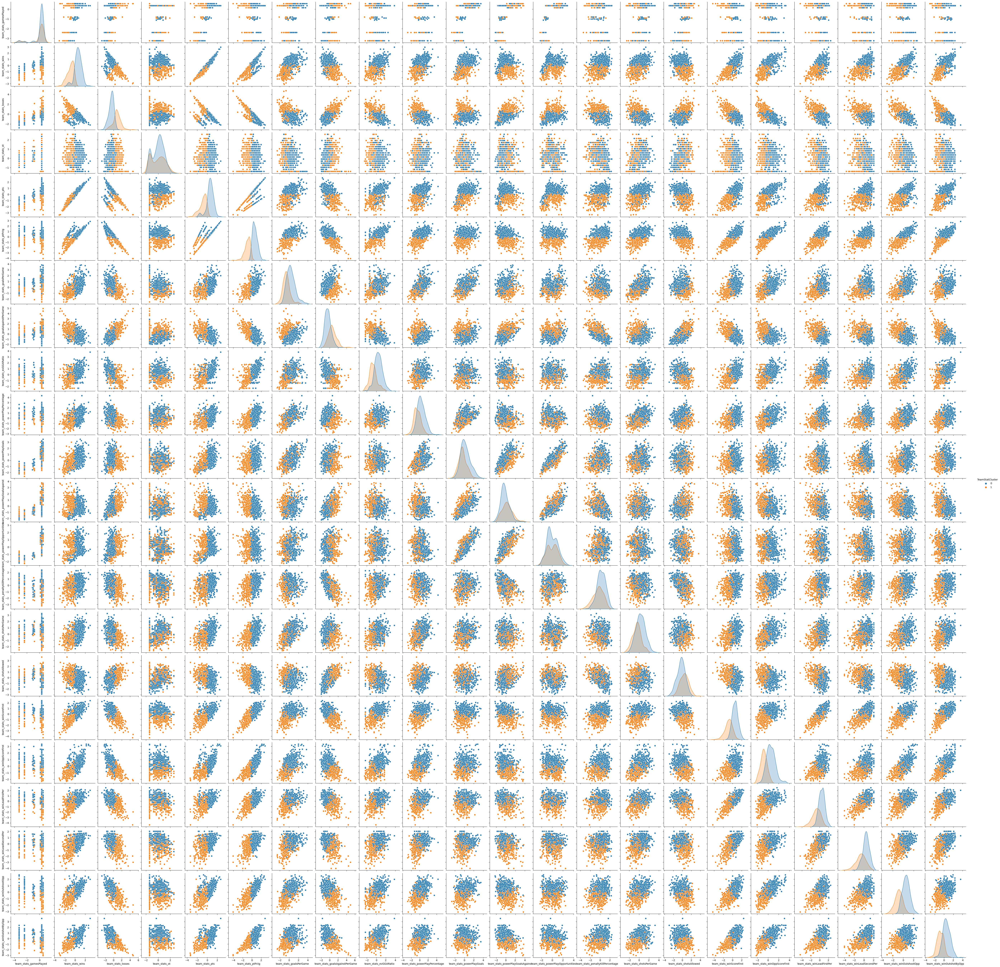

In [79]:
# To see all possible clustering
import seaborn as sns
sns.pairplot(data=df_team_stat_scaled,hue="TeamStatCluster")

In [81]:
# scatter plot using hvPlot by setting 

teamStat_clusters=df_team_stat.hvplot.scatter(
    x="team_stats_pts",
    y="team_stats_ptPctg",
    #by="TeamStatCluster",
    #hover_cols = ["team_name"], 
    title = "Scatter Plot by Team Stat - k=2"
)
teamStat_clusters

:Scatter   [team_stats_pts]   (team_stats_ptPctg)

---

### Optimize Clusters with Principal Component Analysis.

In [87]:
# Create a PCA model instance and set `n_components=3`.
pca = PCA(n_components=3)

In [88]:
# Use the PCA model with `fit_transform` to reduce to 
# three principal components.
team_stat_pca = pca.fit_transform(df_team_stat_scaled)
# View the first five rows of the DataFrame. 
team_stat_pca[:5]

array([[-0.53418914,  1.4357714 ,  0.41242215],
       [-0.52376609,  3.17436021,  1.34246908],
       [-2.55767429,  1.55509626,  0.43399983],
       [ 1.70884167, -4.60323237, -0.86518331],
       [ 0.39680324,  0.31304053, -2.12349612]])

In [89]:
# Retrieve the explained variance to determine how much information 
# can be attributed to each principal component.
pca.explained_variance_ratio_

array([0.41631458, 0.15582778, 0.10774151])

#### Answer the following question: 

**Question:** What is the total explained variance of the three principal components?

**Answer:** 0.678

In [90]:
# Create a new DataFrame with the PCA data.

# Creating a DataFrame with the PCA data
df_team_stat_pca = pd.DataFrame(team_stat_pca, columns=["PC1", "PC2", "PC3"])

# Copy the crypto names from the original data
df_team_stat_pca["season_id"] = df_team_stat_pca.index

# Set the coinid column as index
df_team_stat_pca = df_team_stat_pca.set_index("season_id")

# Display sample data
df_team_stat_pca.head()

,PC1,PC2,PC3
season_id,,,
0,-0.534189,1.435771,0.412422
1,-0.523766,3.174360,1.342469
2,-2.557674,1.555096,0.434000
3,1.708842,-4.603232,-0.865183
4,0.396803,0.313041,-2.123496


---

### Find the Best Value for k Using the PCA Data

In [91]:
# Create a list with the number of k-values from 1 to 11
k_pca = list(range(1, 11))

In [92]:
# Create an empty list to store the inertia values
inertia_pca = []

# Create a for loop to compute the inertia with each possible value of k
# Inside the loop:
# 1. Create a KMeans model using the loop counter for the n_clusters
# 2. Fit the model to the data using `df_team_stat_pca`
# 3. Append the model.inertia_ to the inertia list
for i in k_pca:
    model = KMeans(n_clusters=i, random_state=1)
    model.fit(df_team_stat_pca)
    inertia_pca.append(model.inertia_)

c:\Users\User\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\Users\User\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(
c:\Users\User\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\Users\User\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can a

In [93]:
# Create a dictionary with the data to plot the Elbow curve
elbow_data_pca = {
    "k": k_pca,
    "inertia": inertia_pca
}
# Create a DataFrame with the data to plot the Elbow curve
df_elbow_pca = pd.DataFrame(elbow_data_pca)

In [94]:
# Plot a line chart with all the inertia values computed with 
# the different values of k to visually identify the optimal value for k.
elbow_plot_pca = df_elbow_pca.hvplot.line(x="k", y="inertia", title="Elbow Curve Using PCA Data", xticks=k_pca)
# elbow_plot_pca = df_elbow_pca.hvplot.line(
#     x="k", 
#     y="inertia", 
#     title="Elbow Curve Using PCA Data", 
#     xticks=k_pca
# ).opts(shared_axes=False)
elbow_plot_pca

:Curve   [k]   (inertia)

#### Answer the following questions: 

* **Question:** What is the best value for `k` when using the PCA data?

  * **Answer:** 2


* **Question:** Does it differ from the best k value found using the original data?

  * **Answer:** No, For both k value is 2.

### Cluster Cryptocurrencies with K-means Using the PCA Data

In [95]:
# Initialize the K-Means model using the best value for k
model_mean = KMeans(n_clusters=2)

In [96]:
# Fit the K-Means model using the PCA data
model_mean.fit(df_team_stat_pca)

c:\Users\User\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\Users\User\anaconda3\envs\dev\lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(


KMeans(n_clusters=2)

In [97]:
# Predict the clusters to group the cryptocurrencies using the PCA data
teamStat_clusters_mean = model_mean.predict(df_team_stat_pca)
# Print the resulting array of cluster values.
print(teamStat_clusters_mean)

[1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 0 0 0 1 0 1 0 0 0 0 1 0 1 0 0 0 0
 0 0 0 0 1 0 1 0 1 0 0 0 0 0 1 0 1 1 1 0 1 1 1 1 1 1 0 1 0 1 1 0 0 0 0 0 0
 0 1 1 1 1 1 1 1 1 1 1 1 1 0 0 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1
 1 1 0 1 0 1 1 1 0 1 0 0 0 1 1 1 1 1 0 1 1 1 1 0 0 0 0 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 0 1 1 1 1 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 0 1 1 0 0 1 0 1 0 1 0 0 0 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 1 1 1 1 0 1
 0 1 0 0 0 0 0 1 1 1 1 1 1 1 0 1 1 1 1 1 0 1 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1
 1 1 1 1 0 1 0 1 1 0 1 0 1 0 0 0 0 0 1 0 1 1 0 0 0 0 1 1 1 1 1 1 1 1 0 0 0
 0 0 1 0 0 0 1 1 1 1 1 1 1 0 0 1 1 1 0 0 1 1 1 1 0 1 0 0 0 0 0 0 0 1 1 1 1
 1 0 0 1 0 0 0 1 0 0 0 0 0 0 0 1 0 0 1 0 0 1 1 0 1 0 1 1 1 1 0 0 0 1 0 0 0
 0 0 0 1 1 1 1 0 0 0 1 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 0 1 1 0 1 0 0
 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 0 1 1 0 0 0 0 0 1 0 0 0 0 1 1 1 1 1
 1 1 1 1 1 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0
 0 0 0 0 0 0 0 0 0 0 1 1 

In [98]:
# Create a copy of the DataFrame with the PCA data
df_market_pca_predictions = df_team_stat_pca.copy()

# Add a new column to the DataFrame with the predicted clusters
df_market_pca_predictions["TeamStatCluster_mean"] = teamStat_clusters_mean

# Display sample data
df_market_pca_predictions.head()

,PC1,PC2,PC3,TeamStatCluster_mean
season_id,,,,
0,-0.534189,1.435771,0.412422,1
1,-0.523766,3.174360,1.342469,1
2,-2.557674,1.555096,0.434000,1
3,1.708842,-4.603232,-0.865183,0
4,0.396803,0.313041,-2.123496,1


In [99]:
# Create a scatter plot using hvPlot by setting 
# `x="PC1"` and `y="PC2"`. 
# Color the graph points with the labels found using K-Means and 
# add the crypto name in the `hover_cols` parameter to identify 

teamStat_pca_clusters=df_market_pca_predictions.hvplot.scatter(
    x="PC1",
    y="PC2",
    by="TeamStatCluster_mean",
    hover_cols = ["coin_id"], 
    title = "Scatter Plot by Stock Segment - PCA=2"
)
teamStat_pca_clusters

:NdOverlay   [TeamStatCluster_mean]
   :Scatter   [PC1]   (PC2)

### Visualize and Compare the Results

In this section, you will visually analyze the cluster analysis results by contrasting the outcome with and without using the optimization techniques.

In [100]:
# Composite plot to contrast the Elbow curves
elbow_plot + elbow_plot_pca

:Layout
   .Curve.I  :Curve   [k]   (inertia)
   .Curve.II :Curve   [k]   (inertia)

In [101]:
# Composite plot to contrast the clusters
teamStat_clusters + teamStat_pca_clusters
# YOUR CODE HERE!

:Layout
   .Scatter.I   :Scatter   [team_stats_pts]   (team_stats_ptPctg)
   .NdOverlay.I :NdOverlay   [TeamStatCluster_mean]
      :Scatter   [PC1]   (PC2)

#### Answer the following question: 

  * **Question:** After visually analyzing the cluster analysis results, what is the impact of using fewer features to cluster the data using K-Means?

  * **Answer:** Compare to original data PCA method have clear clustersing.